<a href="https://colab.research.google.com/github/joyzinhw/analise-de-dados/blob/main/atividade_kc_house_Joyce_Moura.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Atividade de Visualização de dados
### PROF. ME. RAFAEL LUZ ARAÚJO

- Apresente os dados de forma visual;
- Use plotagens que mostra informações importantes dos dados;
    - Ex: mapa, scatter plot, correlação dos dados, etc.

In [ ]:
Joyce Moura - ADS V

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

In [ ]:
arquivo = 'kc_house_data.csv'
dataset = pd.read_csv(arquivo, sep=',' ,header=0)

In [ ]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21613 non-null  int64  
 1   date           21613 non-null  object 
 2   price          21613 non-null  float64
 3   bedrooms       21609 non-null  float64
 4   bathrooms      21613 non-null  float64
 5   sqft_living    21613 non-null  int64  
 6   sqft_lot       21613 non-null  int64  
 7   floors         21612 non-null  float64
 8   waterfront     21613 non-null  int64  
 9   view           21613 non-null  int64  
 10  condition      21613 non-null  int64  
 11  grade          21613 non-null  int64  
 12  sqft_above     21613 non-null  int64  
 13  sqft_basement  21613 non-null  int64  
 14  yr_built       21613 non-null  int64  
 15  yr_renovated   21613 non-null  int64  
 16  zipcode        21613 non-null  int64  
 17  lat            21613 non-null  float64
 18  long  

In [ ]:
dataset['price'].describe()

count    2.161300e+04
mean     5.400881e+05
std      3.671272e+05
min      7.500000e+04
25%      3.219500e+05
50%      4.500000e+05
75%      6.450000e+05
max      7.700000e+06
Name: price, dtype: float64

## EXEMPLO: MAPA DE CIRCULOS INFORMANDO AS CASAS COM PREÇOS DESEJAVEIS, ACEITAVEIS OU FORA DO ORÇAMENTO

In [ ]:
# INFORME O VALOR MAXIMO DESEJAVEL E ACEITAVEL
max_desired_price = int(input("Informe o valor máximo desejavel: "))
max_acceptable_price = int(input("Informe o valor máximo aceitavel: "))

Informe o valor máximo desejavel: 4
Informe o valor máximo aceitavel: 5


In [ ]:
# pip install folium
import folium

def create_map(dataset, max_desired_price, max_acceptable_price):
    map = folium.Map(location=[dataset['lat'].mean(), dataset['long'].mean()], zoom_start=10)

    for index, row in dataset.iterrows():

        if row['price'] < max_desired_price:
            color = 'green'
        elif row['price'] < max_acceptable_price:
            color = 'orange'
        else:
            color = 'red'

        folium.CircleMarker(
            location=[row['lat'], row['long']],
            radius=5,
            color=color,
            fill=True,
            fill_color=color,
            fill_opacity=0.7,
            popup=f"Preço: ${row['price']}"
        ).add_to(map)
    return map

In [ ]:
mapa = create_map(dataset, max_desired_price, max_acceptable_price)

In [ ]:
mapa

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
from geopy.distance import geodesic

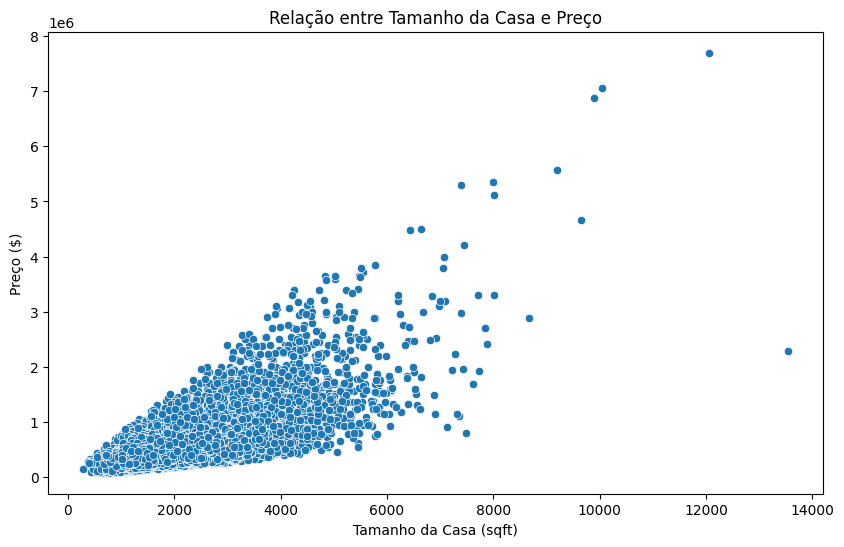

In [ ]:
# Scatter plot de tamanho da casa vs preço
plt.figure(figsize=(10, 6))
sns.scatterplot(data=dataset, x='sqft_living', y='price')
plt.title('Relação entre Tamanho da Casa e Preço')
plt.xlabel('Tamanho da Casa (sqft)')
plt.ylabel('Preço ($)')
plt.show()

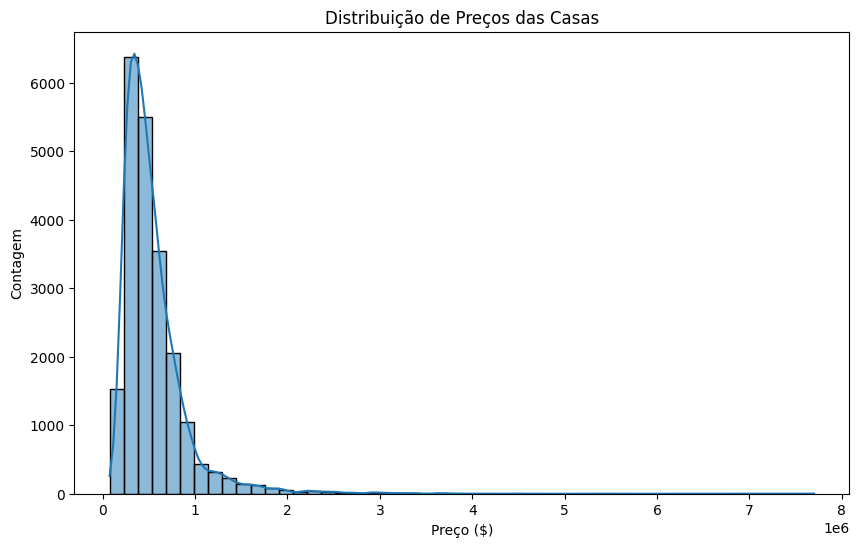

In [ ]:
# Histograma de preços das casas
plt.figure(figsize=(10, 6))
sns.histplot(dataset['price'], bins=50, kde=True)
plt.title('Distribuição de Preços das Casas')
plt.xlabel('Preço ($)')
plt.ylabel('Contagem')
plt.show()

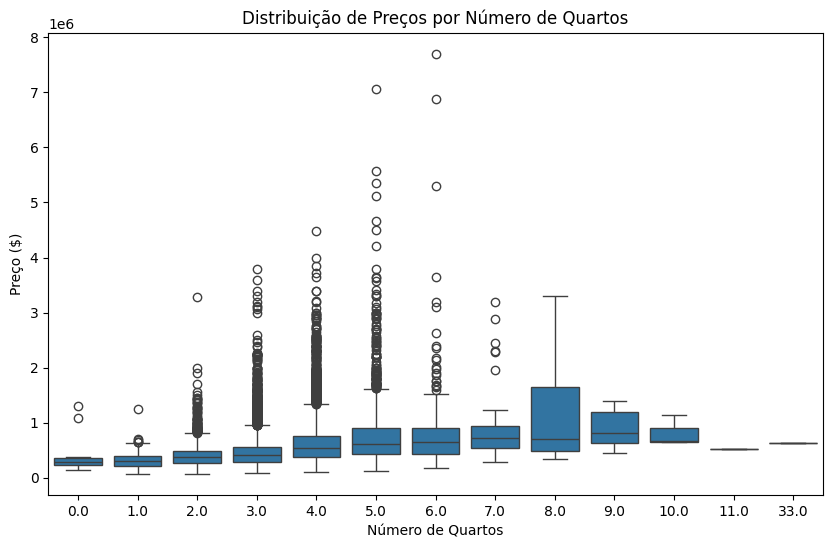

In [ ]:
# Box plot de quartos vs preço
plt.figure(figsize=(10, 6))
sns.boxplot(data=dataset, x='bedrooms', y='price')
plt.title('Distribuição de Preços por Número de Quartos')
plt.xlabel('Número de Quartos')
plt.ylabel('Preço ($)')
plt.show()